<a href="https://colab.research.google.com/github/madeintianjin/ucl_final_project/blob/main/Final_Project_pix2pix_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import time

from keras.models import Model, Sequential
from keras.layers import Dense, Conv2D, Flatten, BatchNormalization, LeakyReLU
from keras.layers import Conv2DTranspose, Dropout, ReLU, Input, Concatenate, ZeroPadding2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
from keras.losses import BinaryCrossentropy
import keras
from google.colab import drive
import glob
import cv2

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
devices = tf.config.experimental.list_physical_devices("cuda")
# tf.config.experimental.set_memory_growth(devices[0] ,enable=True)
print(devices)

[]


In [ ]:
BATCH_SIZE = 1
IMAGE_SIZE = 256

In [ ]:
%mkdir drive/MyDrive/val

In [ ]:
apath = 'drive/MyDrive/test/'

In [ ]:
real_files = sorted(glob.glob("drive/MyDrive/test_real_image/*.jpg"))
input_files = sorted(glob.glob("drive/MyDrive/test_input_mask/*.png"))
n = 0
for x,y in zip(input_files,real_files):
  n += 1
  a = tf.io.read_file(x)
  a = tf.image.decode_jpeg(a, channels=3)

  b = tf.io.read_file(y)
  b = tf.image.decode_png(b, channels=3)
  
  vis = np.concatenate((a, b), axis=1)
  print(vis.shape)
  name = os.path.join(apath,str(n)+'.jpg')
  cv2.imwrite(name,vis)
  # print(name,'saved')
  # plt.savefig(os.path.join(path,str(n)))

In [ ]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image, channels=3)
    w = tf.shape(image)[1]
    w = w//2
    input_image = image[:, :w, :]
    real_image = image[:, w:, :]
    
    input_image = tf.cast(input_image, tf.float32)
    real_image = tf.cast(real_image, tf.float32)
    return input_image,real_image

In [ ]:

#path = "drive/MyDrive"
x,y = load(os.path.join("drive/MyDrive/train/265.jpg"))
print(x.shape, y.shape)

(384, 512, 3) (384, 512, 3)


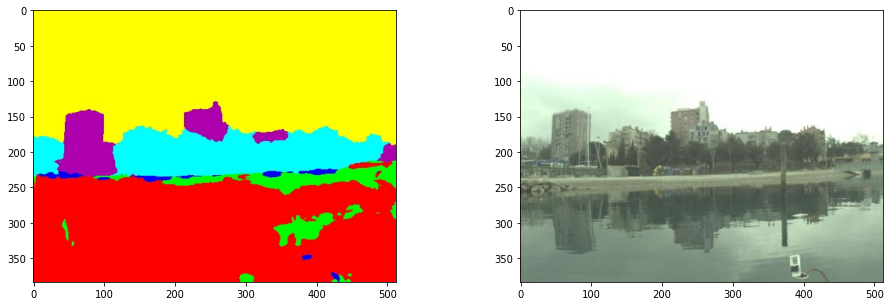

In [ ]:
# visualize
fig, axes = plt.subplots(1,2, figsize = (16,5))
axes[0].imshow(x/255)
axes[1].imshow(y/255)

In [ ]:
def normalize(input_image, real_image):
    input_image = (input_image / 127.5) - 1
    real_image = (real_image / 127.5) - 1
    return input_image, real_image


def resize(input_image, real_image):
    input_image = tf.image.resize(input_image, [IMAGE_SIZE, IMAGE_SIZE], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    real_image = tf.image.resize(real_image, [IMAGE_SIZE, IMAGE_SIZE], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    return input_image, real_image


def random_crop(input_image, real_image):
    stacked_image = tf.stack([input_image, real_image], axis = 0)
    cropped_image = tf.image.random_crop(stacked_image, size = [2, IMAGE_SIZE, IMAGE_SIZE, 3])
    return cropped_image[0], cropped_image[1]
    
    

def random_jitter(input_image, real_image):
    if tf.random.uniform(()) > 0.5:
        input_image = tf.image.flip_left_right(input_image)
        real_image = tf.image.flip_left_right(real_image)
    return input_image, real_image

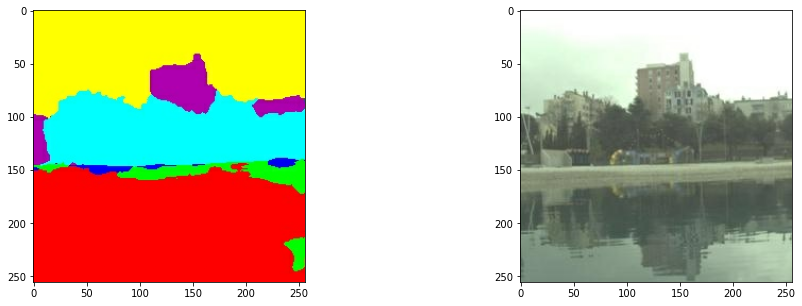

In [ ]:
x_aug, y_aug = random_crop(x, y)
fig, axes = plt.subplots(1,2, figsize = (16,5))
axes[0].imshow(x_aug/255)
axes[1].imshow(y_aug/255.0)

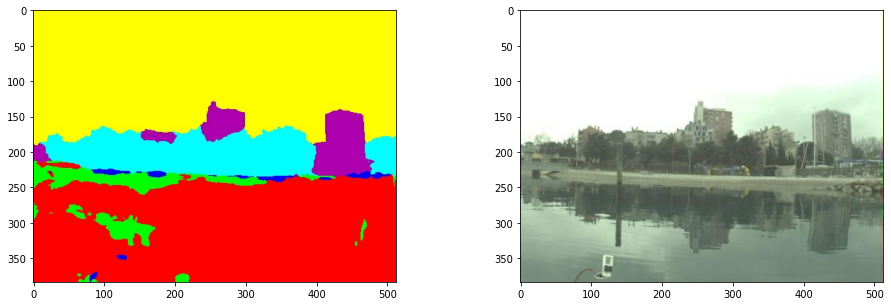

In [ ]:
x_jit, y_jit = random_jitter(x, y)
fig, axes = plt.subplots(1,2, figsize = (16,5))
axes[0].imshow(x_jit/255)
axes[1].imshow(y_jit/255.0)

In [ ]:
def load_train_images(image_path):
    input_image, real_image = load(image_path)
    input_image, real_image = resize(input_image, real_image)
    input_image, real_image = random_jitter(input_image, real_image)
    input_image, real_image = normalize(input_image, real_image)
    return input_image,real_image


def load_test_image(image_path):
    input_image, real_image = load(image_path)
    input_image, real_image = resize(input_image, real_image)
    input_image, real_image = normalize(input_image, real_image)
    return input_image, real_image



In [ ]:
# create train pipeline
train_name = glob.glob("drive/MyDrive/train/*.jpg")
for i in train_name:
  train_dataset = tf.data.Dataset.list_files(i)
  train_dataset = train_dataset.map(load_train_images)
  train_dataset = train_dataset.shuffle(10).batch(BATCH_SIZE)
train_dataset

<BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None))>

In [ ]:
# create test pipeline
test_name = glob.glob("drive/MyDrive/test/*.jpg")
for i in test_name[37:39]:
  test_dataset = tf.data.Dataset.list_files(i)
  test_dataset = test_dataset.map(load_test_image)
  test_dataset = test_dataset.batch(BATCH_SIZE)
test_dataset

<BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None))>

In [ ]:
# create test pipeline
val_dataset = tf.data.Dataset.list_files("drive/MyDrive/val/48.jpg")
val_dataset = val_dataset.map(load_test_image)
val_dataset = val_dataset.batch(BATCH_SIZE)
val_dataset

<BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None))>

In [ ]:
# downsample block
def downsample(filters, size, batchnorm = True):
    init = tf.random_normal_initializer(0.,0.02)
    result = Sequential()
    result.add(Conv2D(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    if batchnorm == True:
        result.add(BatchNormalization())
        
    result.add(LeakyReLU())
    return result


# upsample block
def upsample(filters, size, dropout = False):
    init = tf.random_normal_initializer(0, 0.02)
    result = Sequential()
    result.add(Conv2DTranspose(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    result.add(BatchNormalization())
    if dropout == True:
        result.add(Dropout(0.5))
    result.add(ReLU())
    return result

In [ ]:
def generator():
    inputs = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 3])
    down_stack = [
        downsample(64, 4, batchnorm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4)
    ]
    
    
    up_stack = [
        upsample(512, 4, dropout=True),
        upsample(512, 4, dropout=True),
        upsample(512, 4),
        upsample(512, 4),
        upsample(256, 4),
        upsample(128, 4),
        upsample(64, 4),
    ]
    init = tf.random_normal_initializer(0., 0.02)
    last = Conv2DTranspose(3, 4, strides = 2, padding = "same", kernel_initializer = init, activation ="tanh")
    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = Concatenate()([x, skip])
    
    x = last(x)
    return Model(inputs = inputs, outputs = x)


LAMBDA = 100
loss_function = BinaryCrossentropy(from_logits=True)

def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_function(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    total_gen_loss = gan_loss + (LAMBDA * l1_loss)
    return total_gen_loss, gan_loss, l1_loss


def discriminator():
    init = tf.random_normal_initializer(0., 0.02)
    
    inp = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 3], name = "input_image")
    tar = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 3], name = "target_image")
    x = Concatenate()([inp, tar])
    down1 = downsample(64,4,False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)
    
    zero_pad1 = ZeroPadding2D()(down3)
    conv = Conv2D(256, 4, strides = 1, kernel_initializer = init, use_bias = False)(zero_pad1)
    leaky_relu = LeakyReLU()(conv)
    zero_pad2 = ZeroPadding2D()(leaky_relu)
    last = Conv2D(1, 4, strides = 1, kernel_initializer=init)(zero_pad2)
    return Model(inputs = [inp, tar], outputs = last)


def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_function(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_function(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss

In [ ]:

def save_images(model, test_input, target, epoch):
    aapath = 'drive/MyDrive/output/'
    prediction = model(test_input, training= True)
    plt.figure(figsize = (15,15))
    display_list= [test_input[0], target[0], prediction[0]]
    title = ["Input Image", "Ground Truth", "Predicton Image"]
    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis("off")
    # plt.savefig(f"output/epoch_{epoch}.jpg")
    # plt.close()
    name = os.path.join(aapath,str(epoch)+'.jpg')
    # cv2.imwrite(name,vis)

In [ ]:
down_model = downsample(3,4)
down_result = down_model(tf.expand_dims(x, axis = 0))
print('shape of down sample result',down_result.shape)

up_model = upsample(3,4)
up_result = up_model(down_result)
print('shape of up sample result',up_result.shape)

shape of down sample result (1, 192, 256, 3)
shape of up sample result (1, 384, 512, 3)


In [ ]:
gen = generator()
disc = discriminator()

In [ ]:
generator_optimizer = Adam(lr= 2e-4, beta_1=0.5)
discriminator_optimizer = Adam(lr = 2e-4, beta_1=0.5)

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [ ]:
# make sure output directory exists to save images
if os.path.exists("output"):
    os.mkdir("output")

In [ ]:
epochs = 50

In [ ]:
@tf.function
def train_step(input_image, target, epoch):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = gen(input_image, training = True)
        
        disc_real_output = disc([input_image, target], training = True)
        disc_generated_output = disc([input_image, gen_output], training = True)
        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)
        generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
        discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
        generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))
        return gen_total_loss, disc_loss


def fit(train_ds, epochs, test_ds):
    for epoch in range(epochs):
        start = time.time()
        for input_, target in test_ds.take(10):
            save_images(gen, input_, target, epoch)
        # Train
        print(f"Epoch {epoch}")
        for n, (input_, target) in train_ds.enumerate():
            gen_loss, disc_loss = train_step(input_, target, epoch)
        print("Generator loss {:.2f} Discriminator loss {:.2f}".format(gen_loss, disc_loss))
        print("Time take for epoch {} is {} sec\n".format(epoch+1, time.time() - start))

In [ ]:
keras.backend.clear_session()

Epoch 0
Generator loss 5.82 Discriminator loss 1.29
Time take for epoch 1 is 2.468250036239624 sec

Epoch 1
Generator loss 6.49 Discriminator loss 1.04
Time take for epoch 2 is 2.4749951362609863 sec

Epoch 2
Generator loss 5.85 Discriminator loss 1.08
Time take for epoch 3 is 2.4699206352233887 sec

Epoch 3
Generator loss 6.45 Discriminator loss 0.98
Time take for epoch 4 is 2.5698740482330322 sec

Epoch 4
Generator loss 5.99 Discriminator loss 1.07
Time take for epoch 5 is 2.477799654006958 sec

Epoch 5
Generator loss 6.38 Discriminator loss 1.00
Time take for epoch 6 is 2.43892240524292 sec

Epoch 6
Generator loss 5.34 Discriminator loss 1.05
Time take for epoch 7 is 2.3634450435638428 sec

Epoch 7
Generator loss 6.33 Discriminator loss 0.99
Time take for epoch 8 is 2.4570209980010986 sec

Epoch 8
Generator loss 5.77 Discriminator loss 1.01
Time take for epoch 9 is 2.355527639389038 sec

Epoch 9
Generator loss 5.82 Discriminator loss 0.98
Time take for epoch 10 is 3.3989009857177734

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Epoch 20
Generator loss 5.55 Discriminator loss 1.24
Time take for epoch 21 is 2.4381918907165527 sec

Epoch 21
Generator loss 5.61 Discriminator loss 1.16
Time take for epoch 22 is 2.4048385620117188 sec

Epoch 22
Generator loss 5.96 Discriminator loss 1.02
Time take for epoch 23 is 2.4123313426971436 sec

Epoch 23
Generator loss 5.26 Discriminator loss 1.18
Time take for epoch 24 is 2.675529956817627 sec

Epoch 24
Generator loss 6.16 Discriminator loss 1.25
Time take for epoch 25 is 2.352482318878174 sec

Epoch 25
Generator loss 5.06 Discriminator loss 1.19
Time take for epoch 26 is 2.6207988262176514 sec

Epoch 26
Generator loss 5.74 Discriminator loss 1.02
Time take for epoch 27 is 2.3878908157348633 sec

Epoch 27
Generator loss 5.36 Discriminator loss 1.16
Time take for epoch 28 is 3.076838493347168 sec

Epoch 28
Generator loss 6.39 Discriminator loss 1.17
Time take for epoch 29 is 4.410604953765869 sec

Epoch 29
Generator loss 4.81 Discriminator loss 1.21
Time take for epoch 30 i

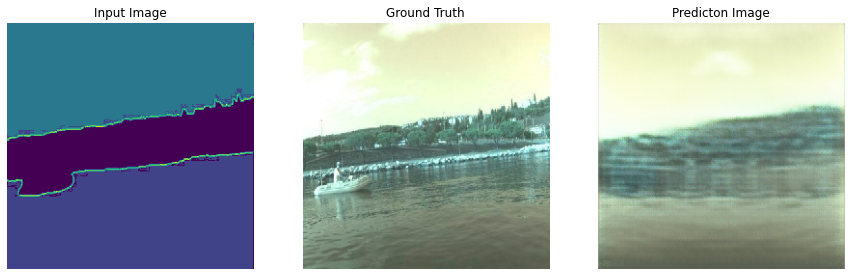

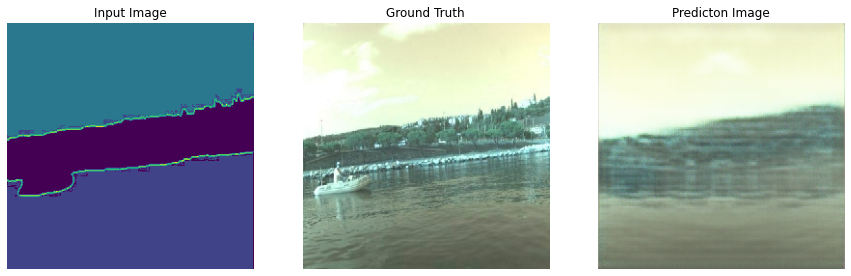

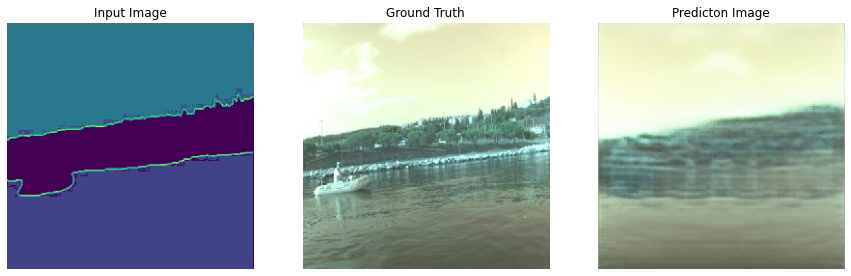

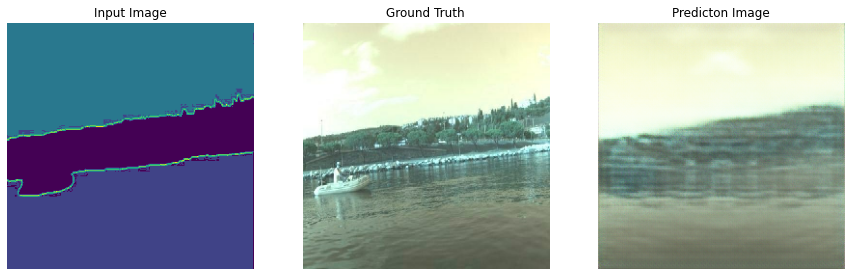

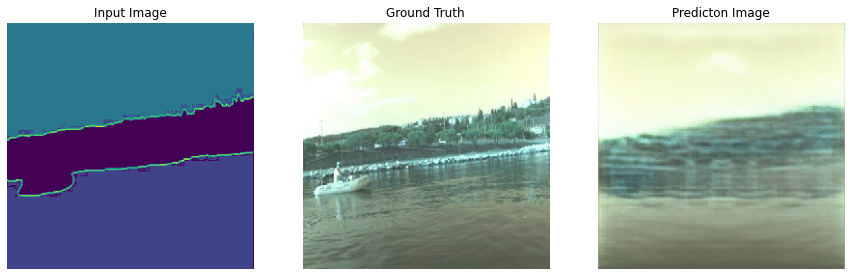

...

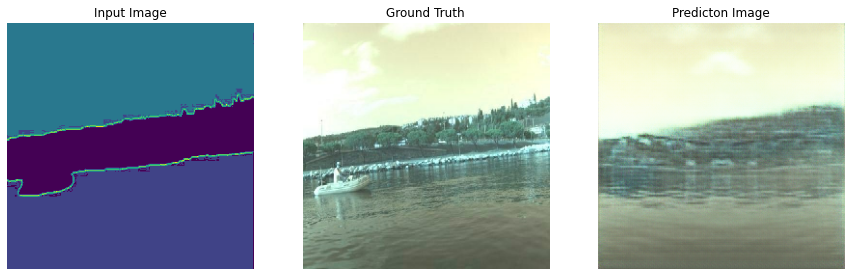

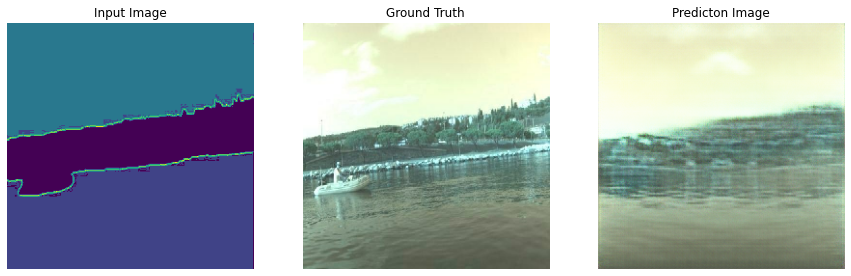

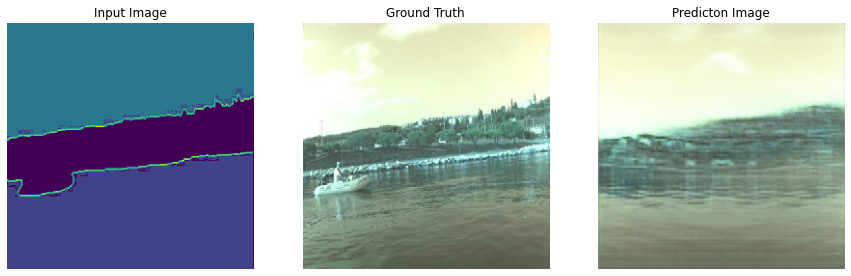

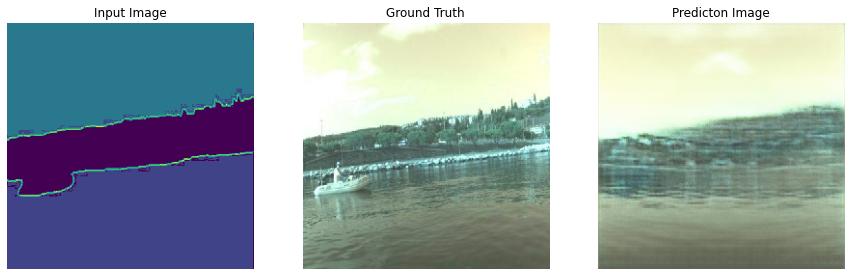

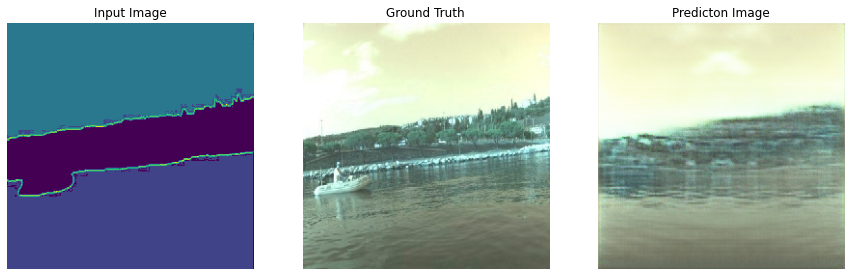

In [ ]:
fit(train_dataset, epochs, val_dataset)

Epoch 0
Generator loss 6.06 Discriminator loss 1.25
Time take for epoch 1 is 2.7254064083099365 sec

Epoch 1
Generator loss 6.39 Discriminator loss 1.22
Time take for epoch 2 is 3.567596673965454 sec

Epoch 2
Generator loss 5.99 Discriminator loss 1.31
Time take for epoch 3 is 4.611260652542114 sec

Epoch 3
Generator loss 6.16 Discriminator loss 1.36
Time take for epoch 4 is 4.596688508987427 sec

Epoch 4
Generator loss 6.25 Discriminator loss 1.42
Time take for epoch 5 is 4.571205139160156 sec

Epoch 5
Generator loss 5.53 Discriminator loss 1.64
Time take for epoch 6 is 4.515196800231934 sec

Epoch 6
Generator loss 6.48 Discriminator loss 1.46
Time take for epoch 7 is 4.79326868057251 sec

Epoch 7
Generator loss 5.43 Discriminator loss 1.59
Time take for epoch 8 is 4.504808187484741 sec

Epoch 8
Generator loss 6.21 Discriminator loss 1.59
Time take for epoch 9 is 4.48230767250061 sec

Epoch 9
Generator loss 5.52 Discriminator loss 1.39
Time take for epoch 10 is 4.5507731437683105 sec


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Epoch 20
Generator loss 5.26 Discriminator loss 1.30
Time take for epoch 21 is 4.512428045272827 sec

Epoch 21
Generator loss 5.16 Discriminator loss 1.29
Time take for epoch 22 is 4.89144229888916 sec

Epoch 22
Generator loss 5.24 Discriminator loss 1.27
Time take for epoch 23 is 4.608459234237671 sec

Epoch 23
Generator loss 5.10 Discriminator loss 1.28
Time take for epoch 24 is 5.291518688201904 sec

Epoch 24
Generator loss 5.16 Discriminator loss 1.29
Time take for epoch 25 is 4.699690818786621 sec

Epoch 25
Generator loss 5.06 Discriminator loss 1.26
Time take for epoch 26 is 4.612363815307617 sec

Epoch 26
Generator loss 5.15 Discriminator loss 1.28
Time take for epoch 27 is 4.594562530517578 sec

Epoch 27
Generator loss 5.08 Discriminator loss 1.31
Time take for epoch 28 is 4.592746019363403 sec

Epoch 28
Generator loss 4.86 Discriminator loss 1.34
Time take for epoch 29 is 4.48521614074707 sec

Epoch 29
Generator loss 5.18 Discriminator loss 1.46
Time take for epoch 30 is 4.517

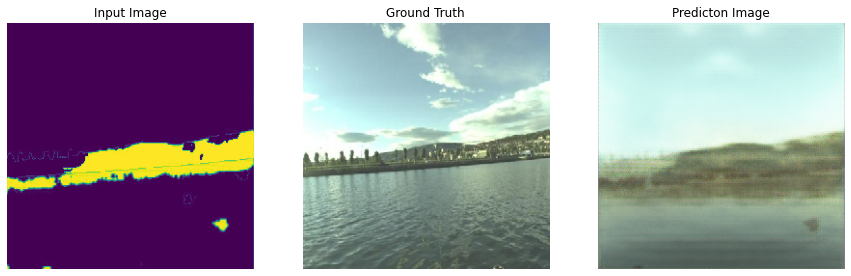

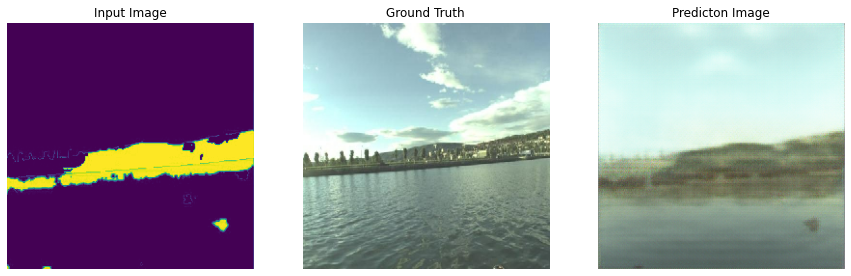

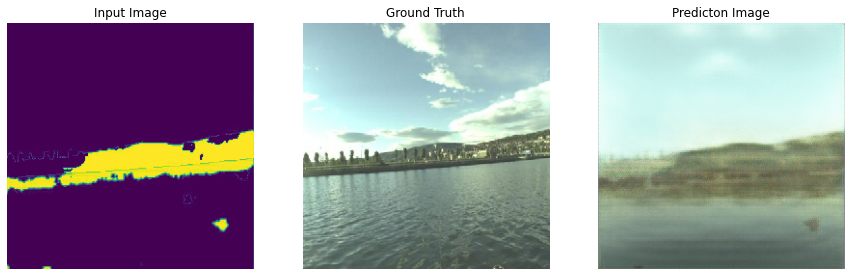

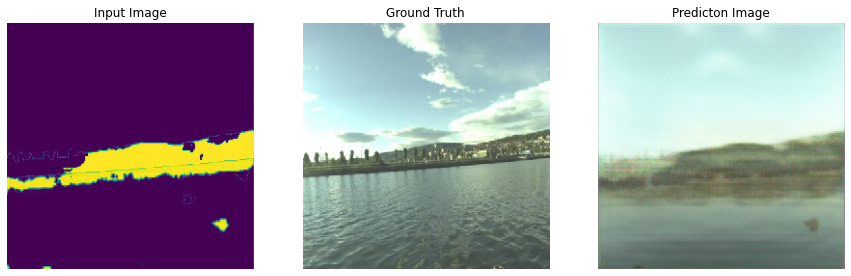

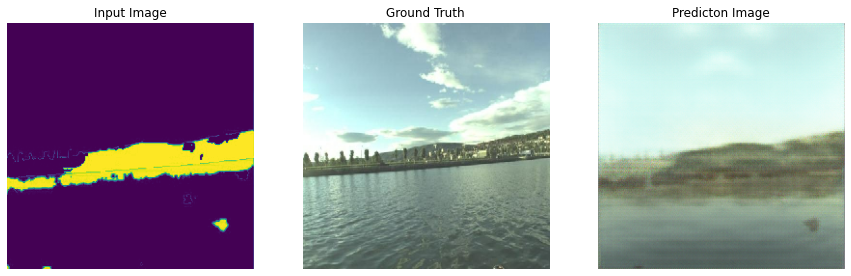

...

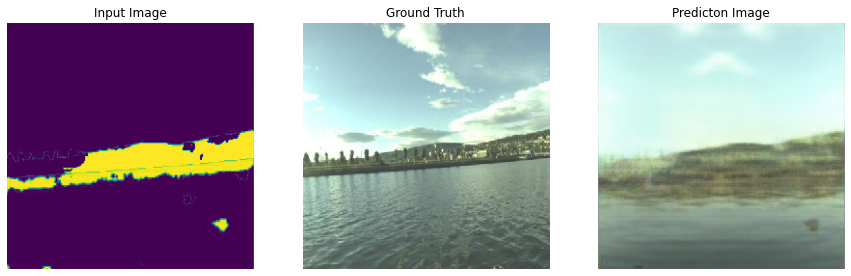

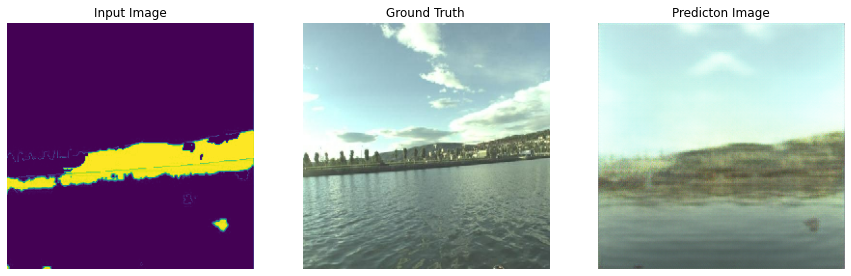

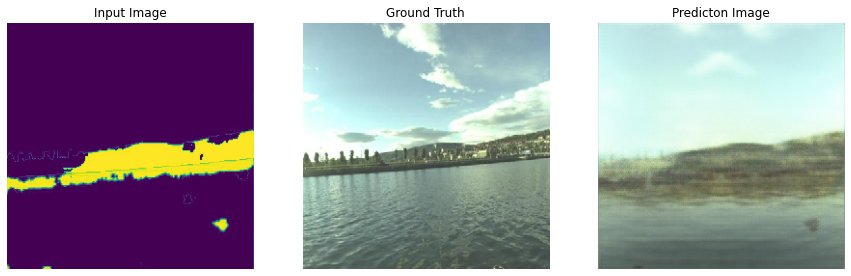

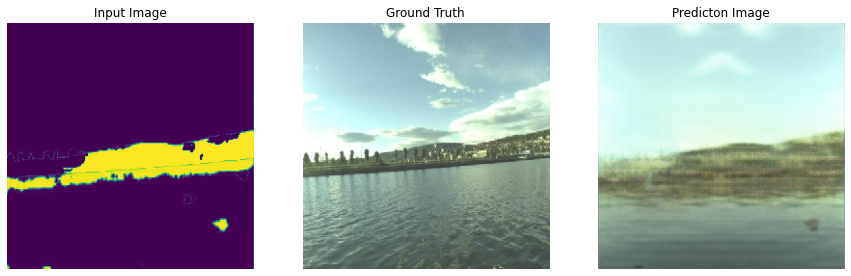

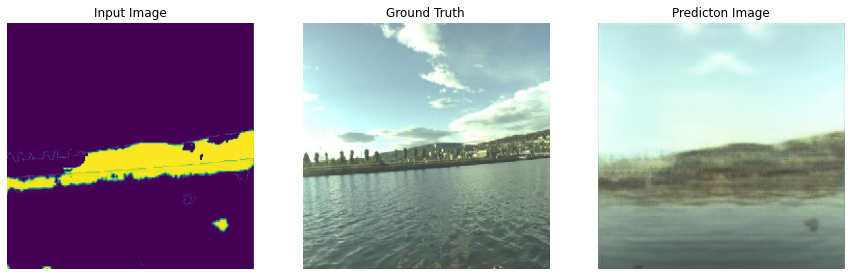

In [ ]:
fit(train_dataset, epochs, test_dataset)

Epoch 0
Generator loss 4.65 Discriminator loss 1.34
Time take for epoch 1 is 2.6701529026031494 sec

Epoch 1
Generator loss 4.52 Discriminator loss 1.31
Time take for epoch 2 is 2.6720633506774902 sec

Epoch 2
Generator loss 4.60 Discriminator loss 1.30
Time take for epoch 3 is 2.6474204063415527 sec

Epoch 3
Generator loss 4.53 Discriminator loss 1.41
Time take for epoch 4 is 2.628204345703125 sec

Epoch 4
Generator loss 4.18 Discriminator loss 1.33
Time take for epoch 5 is 2.6566226482391357 sec

Epoch 5
Generator loss 4.24 Discriminator loss 1.37
Time take for epoch 6 is 2.6644680500030518 sec

Epoch 6
Generator loss 4.34 Discriminator loss 1.40
Time take for epoch 7 is 2.670724630355835 sec

Epoch 7
Generator loss 4.05 Discriminator loss 1.40
Time take for epoch 8 is 2.6881730556488037 sec

Epoch 8
Generator loss 4.36 Discriminator loss 1.33
Time take for epoch 9 is 2.6673905849456787 sec

Epoch 9
Generator loss 4.25 Discriminator loss 1.34
Time take for epoch 10 is 3.3636963367462

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Epoch 20
Generator loss 4.09 Discriminator loss 1.32
Time take for epoch 21 is 2.662076711654663 sec

Epoch 21
Generator loss 4.39 Discriminator loss 1.32
Time take for epoch 22 is 2.6678214073181152 sec

Epoch 22
Generator loss 4.60 Discriminator loss 1.39
Time take for epoch 23 is 2.699146270751953 sec

Epoch 23
Generator loss 3.96 Discriminator loss 1.31
Time take for epoch 24 is 2.6794371604919434 sec

Epoch 24
Generator loss 3.96 Discriminator loss 1.32
Time take for epoch 25 is 2.6694202423095703 sec

Epoch 25
Generator loss 4.03 Discriminator loss 1.31
Time take for epoch 26 is 2.6859304904937744 sec

Epoch 26
Generator loss 4.02 Discriminator loss 1.31
Time take for epoch 27 is 2.6768925189971924 sec

Epoch 27
Generator loss 4.01 Discriminator loss 1.33
Time take for epoch 28 is 2.6434433460235596 sec

Epoch 28
Generator loss 4.10 Discriminator loss 1.37
Time take for epoch 29 is 3.4152822494506836 sec

Epoch 29
Generator loss 3.74 Discriminator loss 1.33
Time take for epoch 30

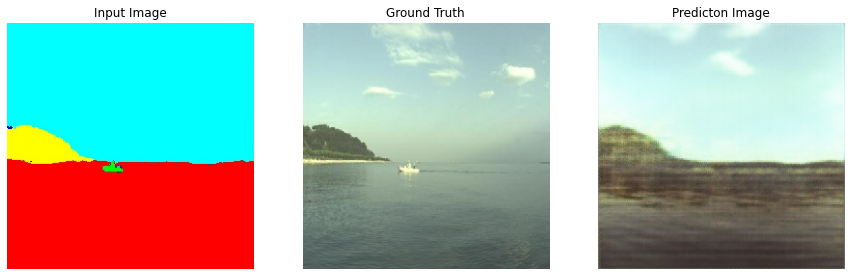

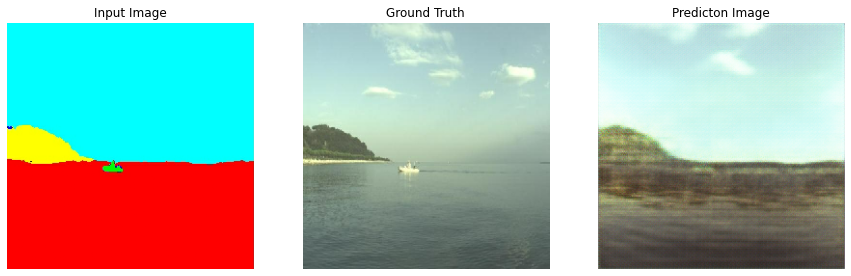

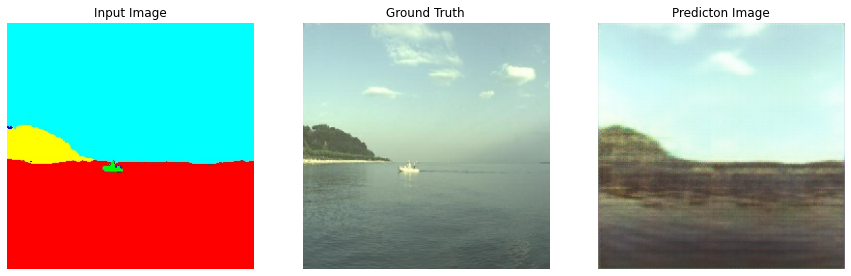

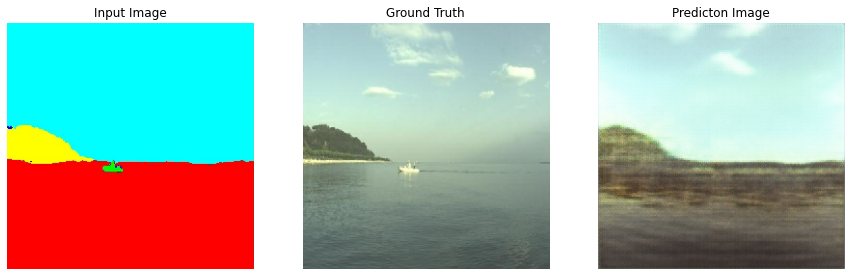

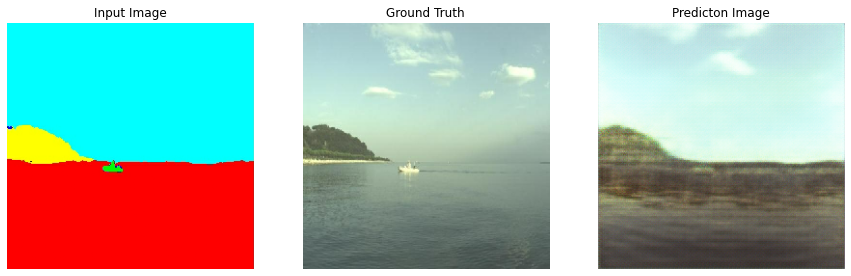

...

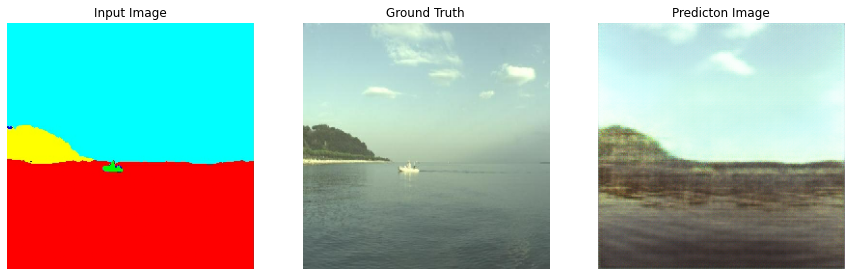

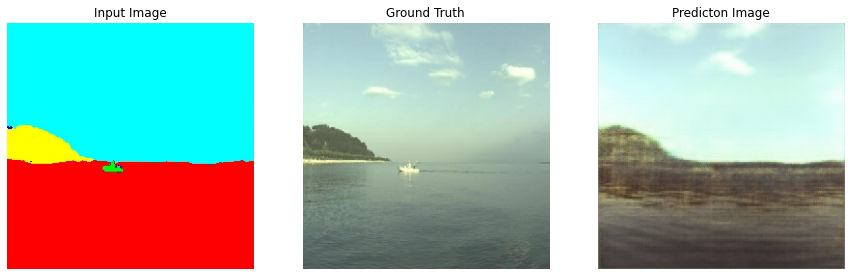

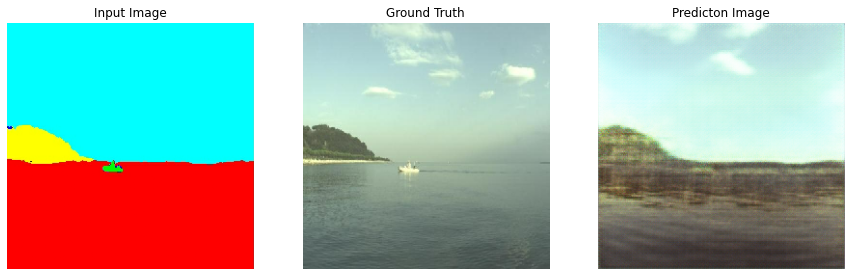

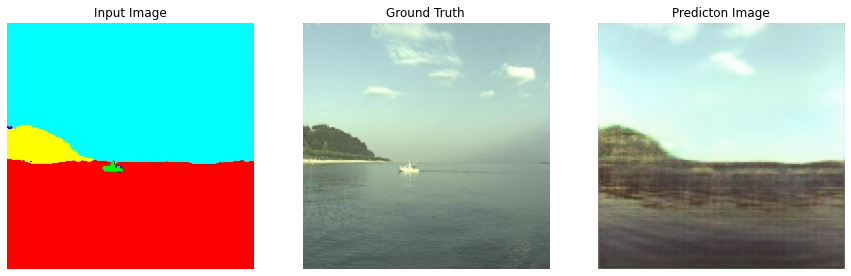

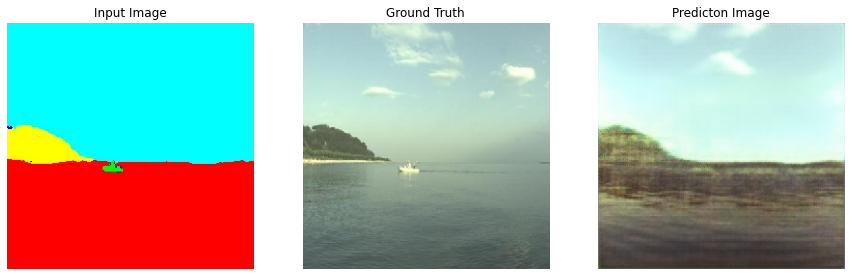

In [ ]:
fit(train_dataset, epochs, test_dataset)